In [2]:
# Libraries and utilities

# RENINDER: FARE FIT.TRANSFORM SOLO SU TRAINING E DOPO SUL TEST SOLO .TRANSFORM
# REMINDER: NORMALIZZARE PRIMA DI FARE TUTTO IL PREPROCESSING 

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
df_train=pd.read_csv("./Dataset/RavdessAudioOnlyFeatures_TRAIN.csv")
df_train.head()

,modality,vocal_channel,emotion,emotional_intensity,statement,repetition,actor,sex,filename,frame_count,...,stft_max_w4,stft_q01_w4,stft_q05_w4,stft_q25_w4,stft_q50_w4,stft_q75_w4,stft_q95_w4,stft_q99_w4,stft_kur_w4,stft_skew_w4
0,audio-only,speech,neutral,normal,Kids are talking by the door,1st,1,M,03-01-01-01-01-01-01.wav,158558,...,1.0,0.000000,0.566462,0.709962,0.799141,0.896606,1.0,1.0,6.742190,-1.706215
1,audio-only,speech,neutral,normal,Kids are talking by the door,2nd,1,M,03-01-01-01-01-02-01.wav,160160,...,1.0,0.368623,0.472736,0.623183,0.744908,0.874713,1.0,1.0,-0.700420,-0.201495
2,audio-only,speech,neutral,normal,Dogs are sitting by the door,1st,1,M,03-01-01-01-02-01-01.wav,156956,...,1.0,0.000000,0.417919,0.643636,0.774253,0.899156,1.0,1.0,1.688986,-1.024773
3,audio-only,speech,neutral,normal,Dogs are sitting by the door,2nd,1,M,03-01-01-01-02-02-01.wav,152152,...,1.0,0.306280,0.399641,0.606910,0.755213,0.886474,1.0,1.0,-0.594111,-0.412871
4,audio-only,speech,calm,normal,Kids are talking by the door,1st,1,M,03-01-02-01-01-01-01.wav,169769,...,1.0,0.248765,0.428202,0.634815,0.759914,0.878014,1.0,1.0,0.126535,-0.620782


In [5]:
df_test=pd.read_csv("./Dataset/RavdessAudioOnlyFeatures_TEST.csv")
df_test.head()

,modality,vocal_channel,emotion,emotional_intensity,statement,repetition,actor,sex,filename,frame_count,...,stft_max_w4,stft_q01_w4,stft_q05_w4,stft_q25_w4,stft_q50_w4,stft_q75_w4,stft_q95_w4,stft_q99_w4,stft_kur_w4,stft_skew_w4
0,audio-only,speech,neutral,normal,Kids are talking by the door,1st,19,M,03-01-01-01-01-01-19.wav,161762,...,1.0,0.306697,0.466157,0.645931,0.789123,0.908316,1.0,1.0,-0.260279,-0.566556
1,audio-only,speech,neutral,normal,Kids are talking by the door,2nd,19,M,03-01-01-01-01-02-19.wav,155355,...,1.0,0.170786,0.279347,0.557524,0.733053,0.866973,1.0,1.0,-0.428900,-0.587210
2,audio-only,speech,neutral,normal,Dogs are sitting by the door,1st,19,M,03-01-01-01-02-01-19.wav,160160,...,1.0,0.023285,0.305395,0.577750,0.741576,0.889984,1.0,1.0,0.626916,-0.883317
3,audio-only,speech,neutral,normal,Dogs are sitting by the door,2nd,19,M,03-01-01-01-02-02-19.wav,158558,...,1.0,0.368081,0.434591,0.620144,0.776419,0.904668,1.0,1.0,-0.825144,-0.383701
4,audio-only,speech,calm,normal,Kids are talking by the door,1st,19,M,03-01-02-01-01-01-19.wav,176176,...,1.0,0.298851,0.393112,0.623309,0.772964,0.907035,1.0,1.0,-0.536669,-0.547354


In [47]:
print(f"df_train shape = {df_train.shape}\ndf_test shape = {df_test.shape}")

df_train shape = (1828, 434)
df_test shape = (624, 434)


# Understanding df_train

In [22]:
null_counts = df_train.isnull().sum()
null_counts[null_counts > 0].sort_values(ascending=False)
# NO NAN

Series([], dtype: int64)

In [29]:
c = df_train.columns[df_train.eq(df_train.iloc[0]).all()].tolist()
print("These columns has a constant value:\n")
print (c)


These columns has a constant value:

['modality', 'lag1_q50', 'zc_min', 'zc_max', 'zc_q01', 'zc_q05', 'zc_q25', 'zc_q50', 'zc_q75', 'zc_q99', 'stft_max', 'stft_q95', 'stft_q99', 'lag1_q50_w1', 'zc_min_w1', 'zc_max_w1', 'zc_q01_w1', 'zc_q05_w1', 'zc_q25_w1', 'zc_q50_w1', 'zc_q75_w1', 'zc_min_w2', 'zc_max_w2', 'zc_q01_w2', 'zc_q05_w2', 'zc_q25_w2', 'zc_q50_w2', 'zc_q75_w2', 'zc_q99_w2', 'stft_max_w2', 'stft_q95_w2', 'stft_q99_w2', 'zc_min_w3', 'zc_max_w3', 'zc_q01_w3', 'zc_q05_w3', 'zc_q25_w3', 'zc_q50_w3', 'zc_q75_w3', 'zc_q99_w3', 'stft_max_w3', 'stft_q95_w3', 'stft_q99_w3', 'lag1_q50_w4', 'zc_min_w4', 'zc_max_w4', 'zc_q01_w4', 'zc_q05_w4', 'zc_q25_w4', 'zc_q50_w4', 'stft_max_w4', 'stft_q99_w4']


In [60]:
print("These columns are categorical")
c=df_train.select_dtypes(include=['object']).columns.tolist()
c

These columns are categorical


['modality',
 'vocal_channel',
 'emotion',
 'emotional_intensity',
 'statement',
 'repetition',
 'sex',
 'filename']

<AxesSubplot:xlabel='modality', ylabel='count'>

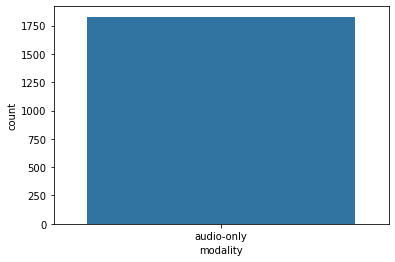

In [61]:
sns.countplot(data=df_train,x='modality')

<AxesSubplot:xlabel='vocal_channel', ylabel='count'>

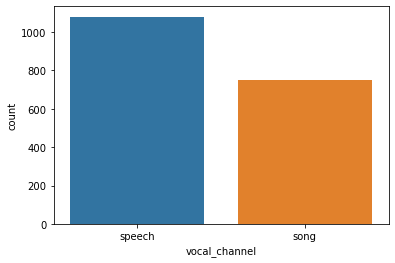

In [48]:
sns.countplot(data=df_train,x='vocal_channel')

<AxesSubplot:xlabel='emotion', ylabel='count'>

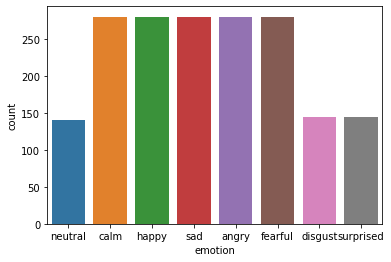

In [49]:
sns.countplot(data=df_train,x='emotion')

<AxesSubplot:xlabel='emotional_intensity', ylabel='count'>

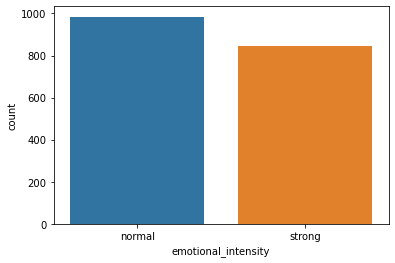

In [50]:
sns.countplot(data=df_train,x='emotional_intensity')

<AxesSubplot:xlabel='statement', ylabel='count'>

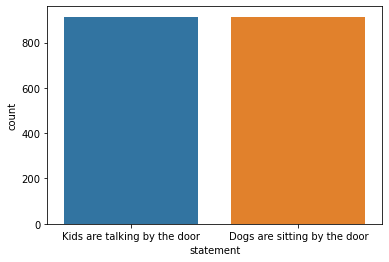

In [51]:
sns.countplot(data=df_train,x='statement')

<AxesSubplot:xlabel='repetition', ylabel='count'>

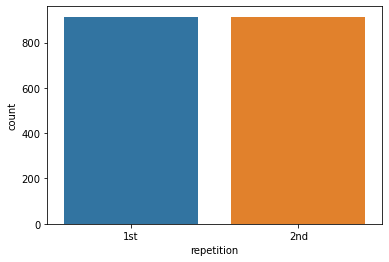

In [52]:
sns.countplot(data=df_train,x='repetition')

<AxesSubplot:xlabel='sex', ylabel='count'>

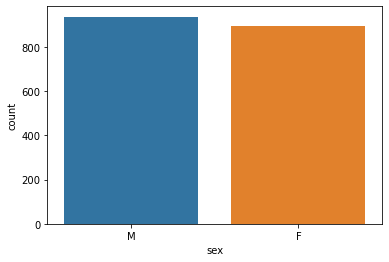

In [53]:
sns.countplot(data=df_train,x='sex')

<AxesSubplot:xlabel='actor', ylabel='count'>

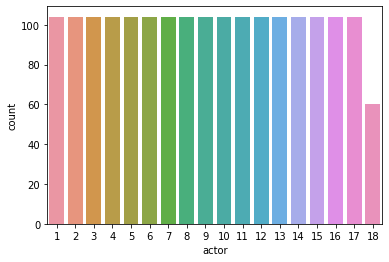

In [62]:
sns.countplot(data=df_train,x='actor')

In [63]:
df_train['actor'].value_counts()

1     104
2     104
17    104
16    104
15    104
14    104
13    104
12    104
11    104
10    104
9     104
8     104
7     104
6     104
5     104
4     104
3     104
18     60
Name: actor, dtype: int64

Boxplot for non categorical variables

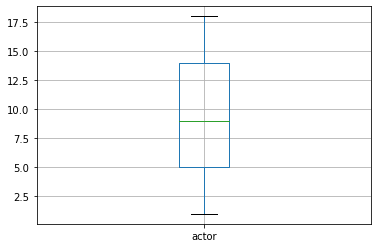

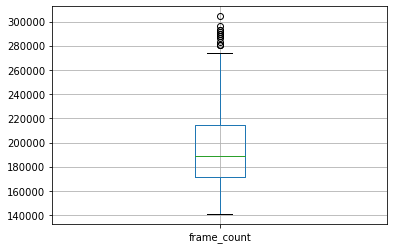

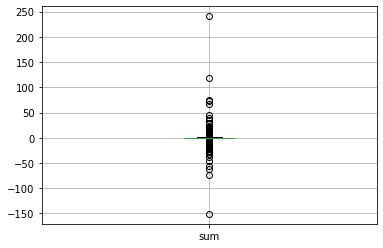

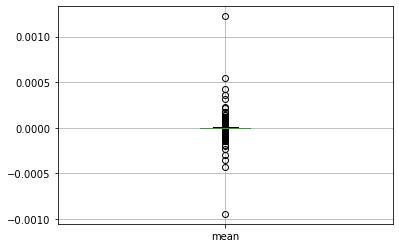

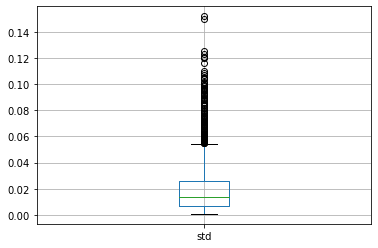

...

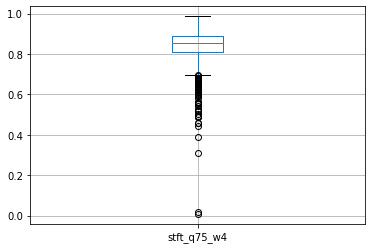

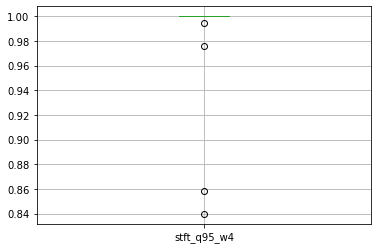

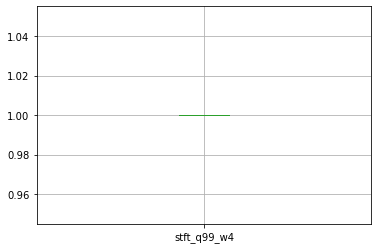

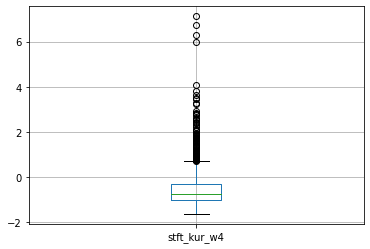

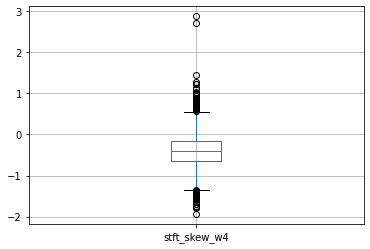

In [66]:
c2=df_train.select_dtypes(exclude=['object']).columns.tolist()
for s in c2:
    df_train.boxplot(column=[s])
    plt.show()


# Matrix Correlation with Pearson

In [4]:
df_train.corr(method="pearson").style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1)